# Examen Parcial PDyA - 8 de noviembre de 2024
Trabajos individuales. Se presentarán el día del examen.

1. Inserta la imagen del personaje que se proporciona en un escenario natural (imagen chroma del conejo). Debe tener contenido por encima y por debajo (el personaje queda parcialmente ocluido por elementos de la escena natural). Debe realizarse un Notebook de Jupyter de forma motivada.
2. Utilizar este personaje y otro u otros para realizar un GIF animado, también en un Notebook de Jupyter explicando cómo se hace.

## Chroma conejo

In [361]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

modo:  RGB
(ancho, alto) = (1920, 1271)


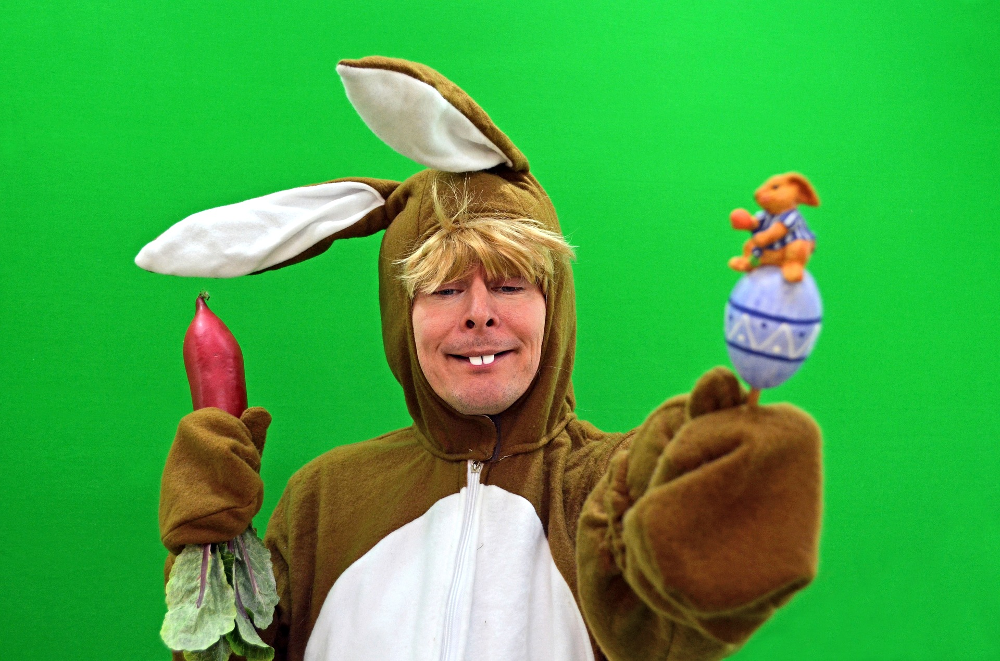

In [362]:
fileConejo = 'images/chroma-key-2096587_1920.jpg'
img  = Image.open(fileConejo)
print('modo: ', img.mode)
print('(ancho, alto) =', img.size)
display(img)

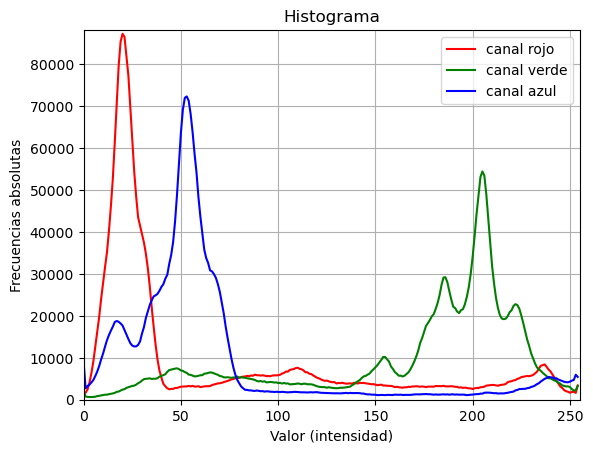

In [363]:
img_hist = np.array(img.histogram())
img_hist_R = img_hist[0:255]
img_hist_G = img_hist[256:511]
img_hist_B = img_hist[512:767]

plt.plot(img_hist_R, color='r', label='canal rojo')
plt.plot(img_hist_G, color='g', label='canal verde')
plt.plot(img_hist_B, color='b', label='canal azul')

plt.axis([0,255, 0, 1.01*img_hist.max()])
plt.legend(loc='upper right')

plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()

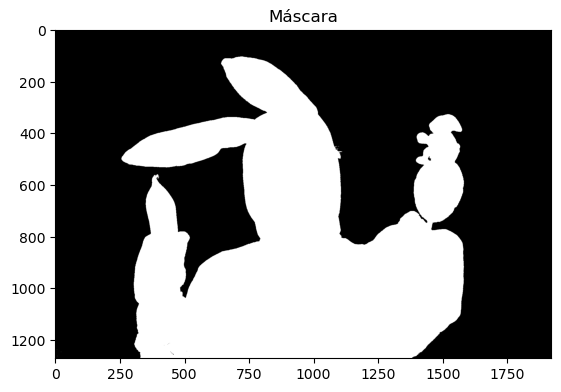

In [364]:
#Como se puede apreciar en el histograma, el canal verde tiene gran presencia en los valores por encima de 130.
#Esto, a priori, se correspondería con el fondo.
img_np = np.array(img)

"""mask_r = np.logical_and(img_np[:,:,0] >= 0, img_np[:,:,0] <= 100)
mask_g = np.logical_and(img_np[:,:,1] >= 130, img_np[:,:,1] <= 255)
mask_b = np.logical_and(img_np[:,:,2] >= 0, img_np[:,:,2] <= 100)

mask = np.logical_and(mask_b, np.logical_and(mask_r, mask_g))
mask = np.logical_not(mask)
mask = mask.astype('uint8')*255"""

mask_r = img_np[:,:,0] >= 100
mask_g = img_np[:,:,1] <= 130
mask_b = img_np[:,:,2] >= 100

mask = np.logical_or(mask_b, np.logical_or(mask_r, mask_g))
mask = mask.astype('uint8')*255

plt.title('Máscara')
plt.imshow(mask, cmap='gray');

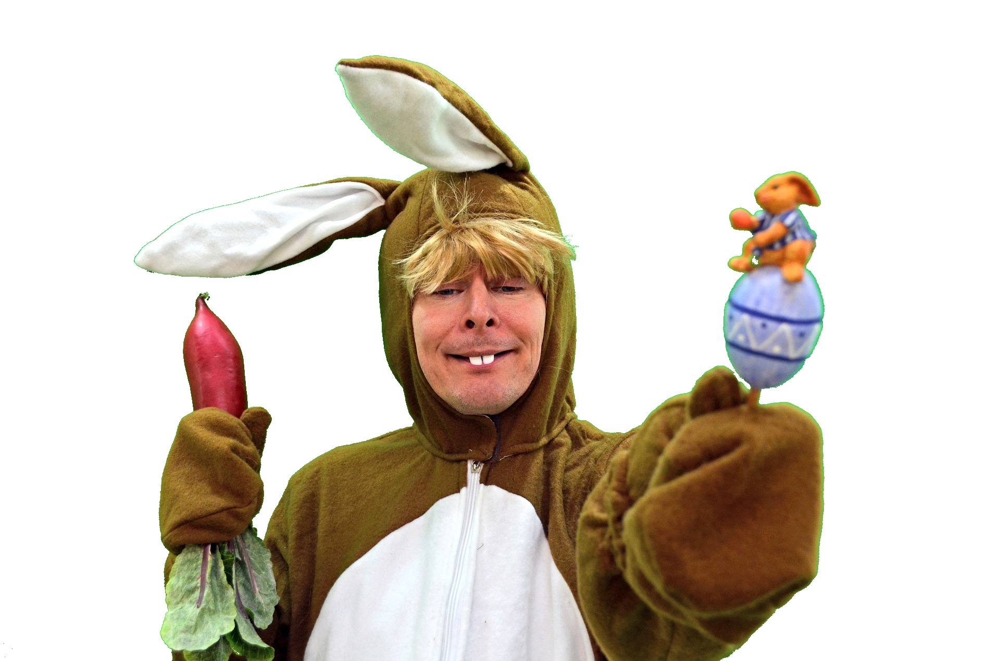

In [365]:
#Generamos imagen con canal alfa a partir de la máscara
conejo_RGBA = Image.fromarray(np.concatenate((img_np, mask[..., np.newaxis]), axis=2))
display(conejo_RGBA)

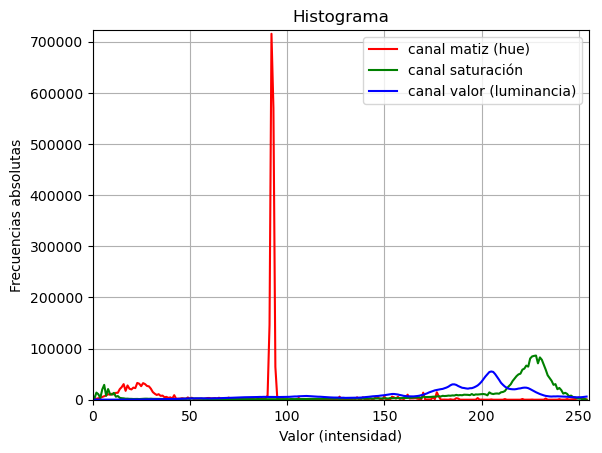

In [366]:
# Ahora voy a tratar de hacer el chroma con formato de imagen HSV
img_hsv = img.convert("HSV")
img_hsv_hist = np.array(img_hsv.histogram())

img_hist_H = img_hsv_hist[0:255]
img_hist_S = img_hsv_hist[256:511]
img_hist_V = img_hsv_hist[512:767]

plt.plot(img_hist_H, color='r', label='canal matiz (hue)')
plt.plot(img_hist_S, color='g', label='canal saturación')
plt.plot(img_hist_V, color='b', label='canal valor (luminancia)')

plt.axis([0,255, 0, 1.01*img_hsv_hist.max()])
plt.legend(loc='upper right')

plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()

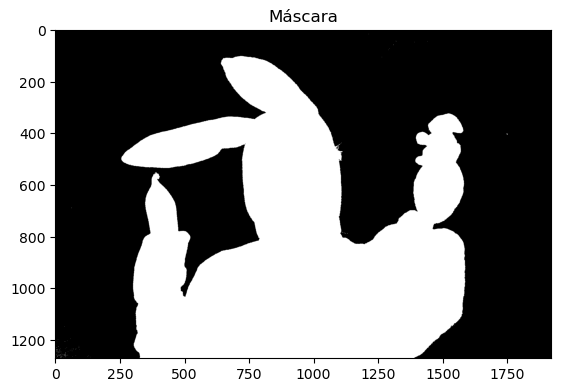

In [367]:
img_hsv_np = np.array(img_hsv)

mask_h = np.logical_or(img_hsv_np[:,:,0] <= 85, img_hsv_np[:,:,0] >= 100)
mask_s = img_hsv_np[:,:,1] <= 200
mask_v = np.logical_or(img_hsv_np[:,:,2] < 135, img_hsv_np[:,:,2] > 240)

mask_hsv = np.logical_or(mask_h, np.logical_or(mask_v,mask_s))
mask_hsv = mask_hsv.astype('uint8')*255

plt.title('Máscara')
plt.imshow(mask_hsv, cmap='gray');

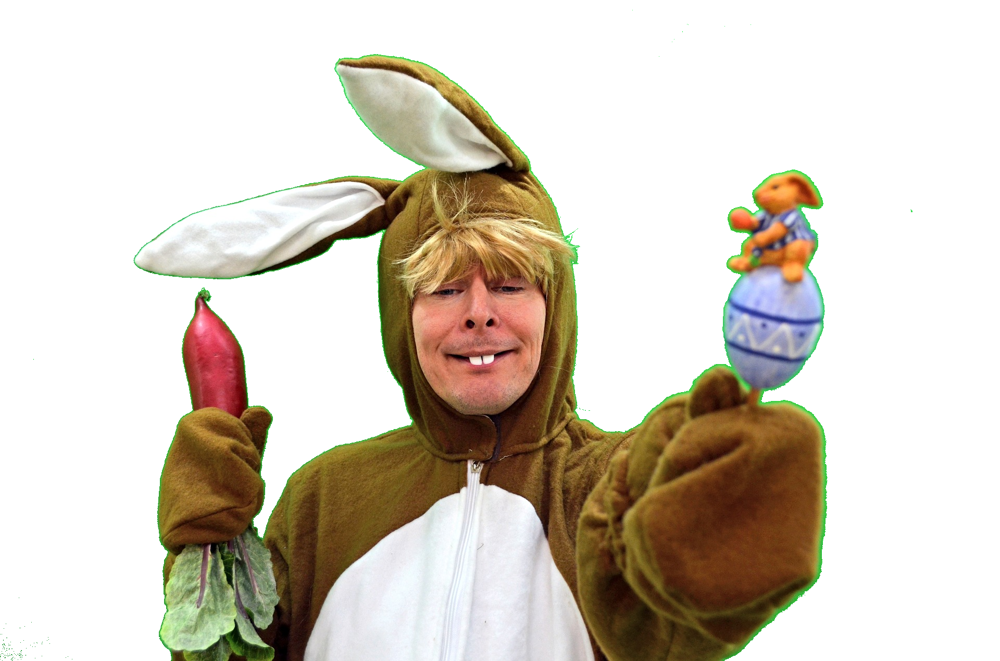

In [368]:
#Generamos imagen con canal alfa a partir de la máscara
conejo_RGBA2 = Image.fromarray(np.concatenate((img_np, mask_hsv[..., np.newaxis]), axis=2))
display(conejo_RGBA2)

In [369]:
#El recorte de los bordes del chroma ha quedado mejor haciendo la máscara en RGB
#Por tanto será esa (conejo_RGBA) la que utilice de aquí en adelante.

## Inserción en un espacio natural

formato: JPEG
(ancho, alto) = (1024, 676)
modo:  RGB


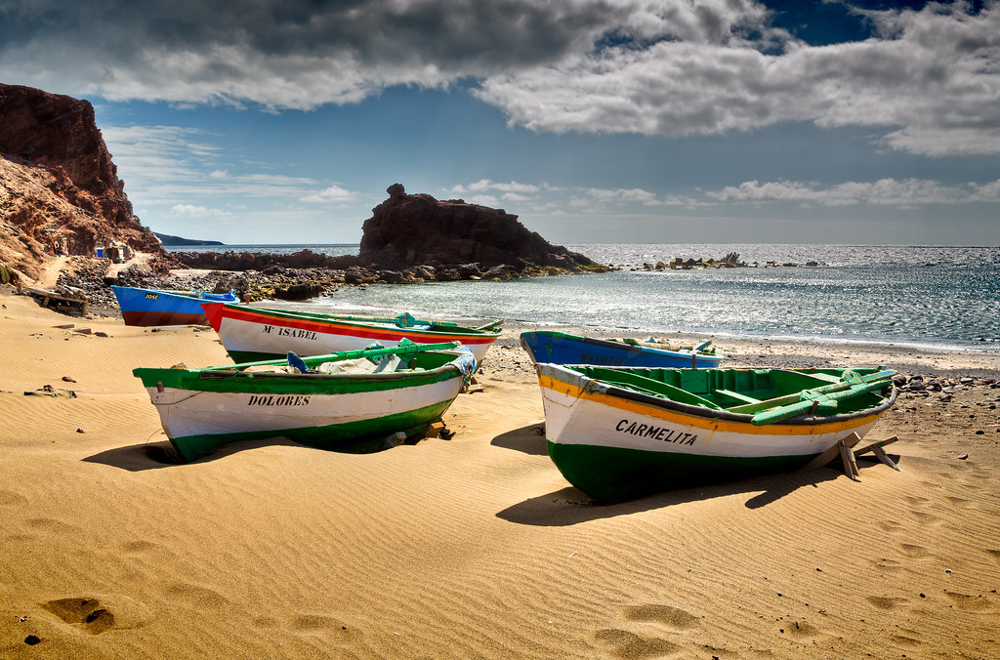

In [370]:
# Escenario natural
fileplaya = 'images/el_burrero.jpg'
img  = Image.open(fileplaya)
print('formato:', img.format)
print('(ancho, alto) =', img.size)
print('modo: ', img.mode)
display(img)

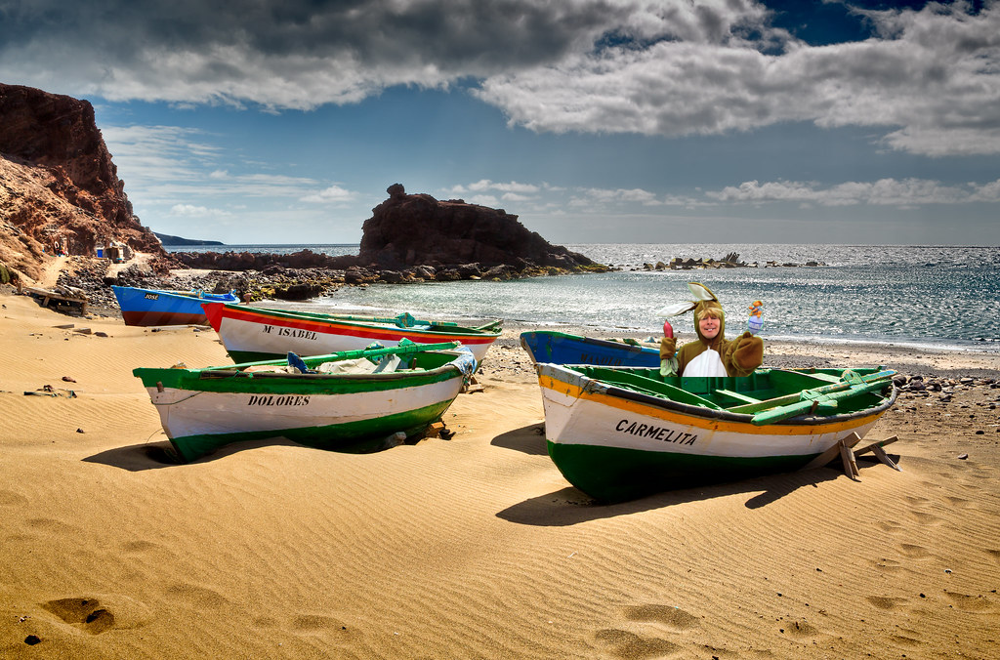

In [371]:
# Añadimos el conejo
conejo_reescalado = conejo_RGBA.resize(size=(160,106))
conejo_RGBA = conejo_reescalado.convert(mode='RGBA')
img = img.convert(mode='RGBA')
img.alpha_composite(conejo_RGBA, dest = (650, 280))
img

<class 'PIL.PngImagePlugin.PngImageFile'>
1676426966464
formato: PNG
(ancho, alto) = (1024, 676)
Número de píxeles = 692224
modo:  RGBA


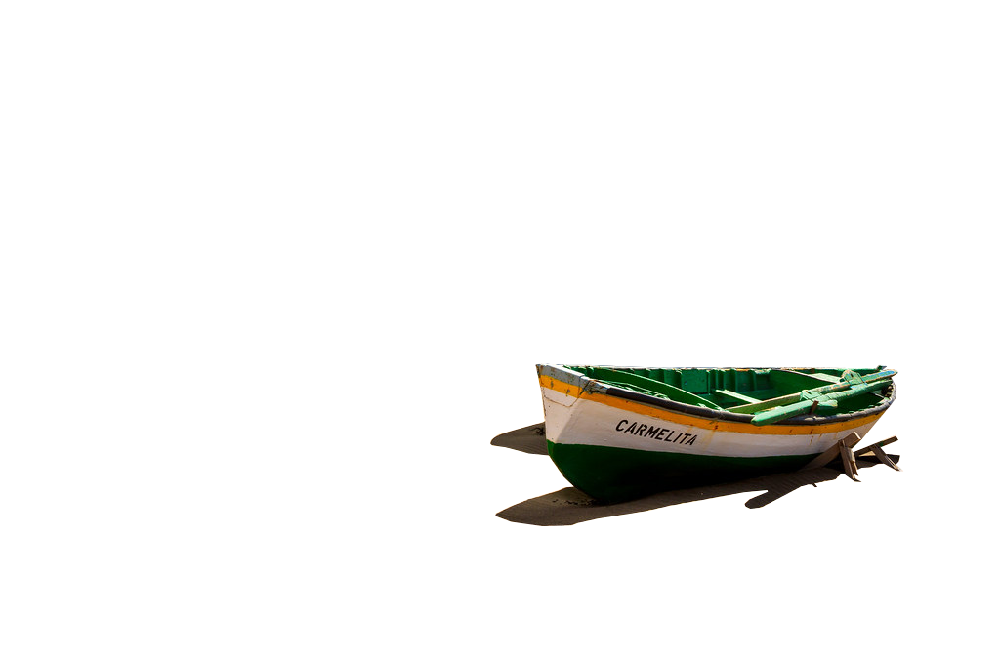

In [372]:
# Para hacer bien el corte entre la barca y el conejo, recurrimos a una imagen en la que está recortada solo la barca
fileBarca = 'images/el_burrero_barca.png'
img2  = Image.open(fileBarca)
print(type(img2))
print(id(img2))
print('formato:', img2.format)
print('(ancho, alto) =', img2.size)
n_pixels = img2.size[0]*img2.size[1]
print('Número de píxeles =', n_pixels)
print('modo: ', img2.mode)
display(img2)

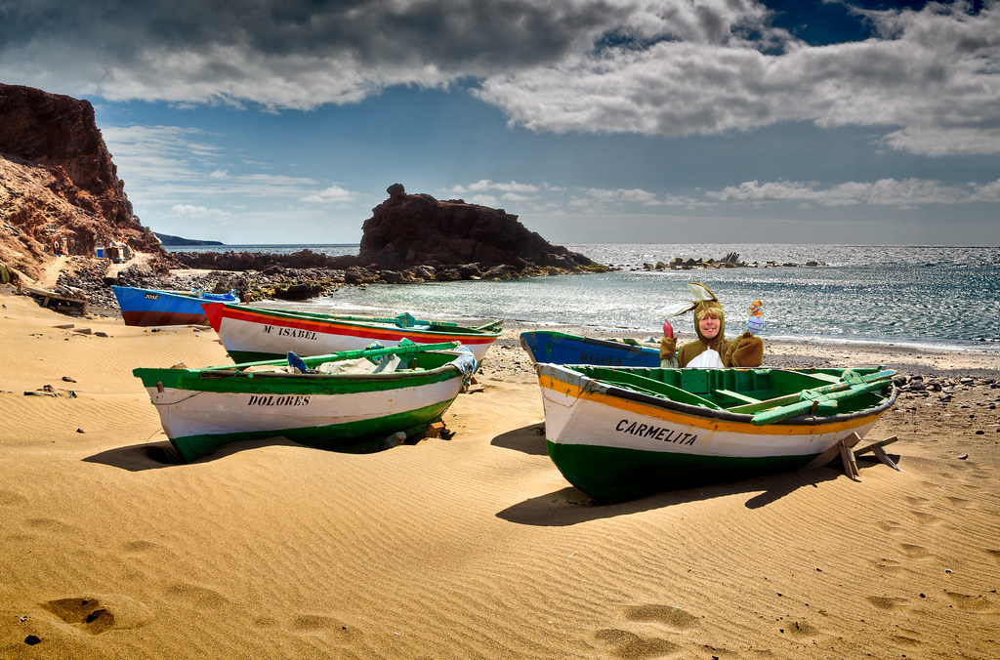

In [373]:
img = img.convert(mode='RGBA')
img.alpha_composite(img2)
img

## 

In [374]:
#Vuelvo al fondo original, para ahora hacer la secuencia de imágenes del gif
img  = Image.open(fileplaya)
fileCangrejo = 'images/crab.png'
imgcrab  = Image.open(fileCangrejo)
print('modo: ', img.mode)
print('(ancho, alto) =', img.size)

modo:  RGB
(ancho, alto) = (1024, 676)


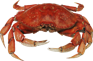

In [375]:
crab = imgcrab.resize(size=(93,61))
crab = crab.convert(mode='RGBA')
crab

In [376]:
a = 0
b = 0
desplazamiento_a = -5
desplazamiento_b = 12

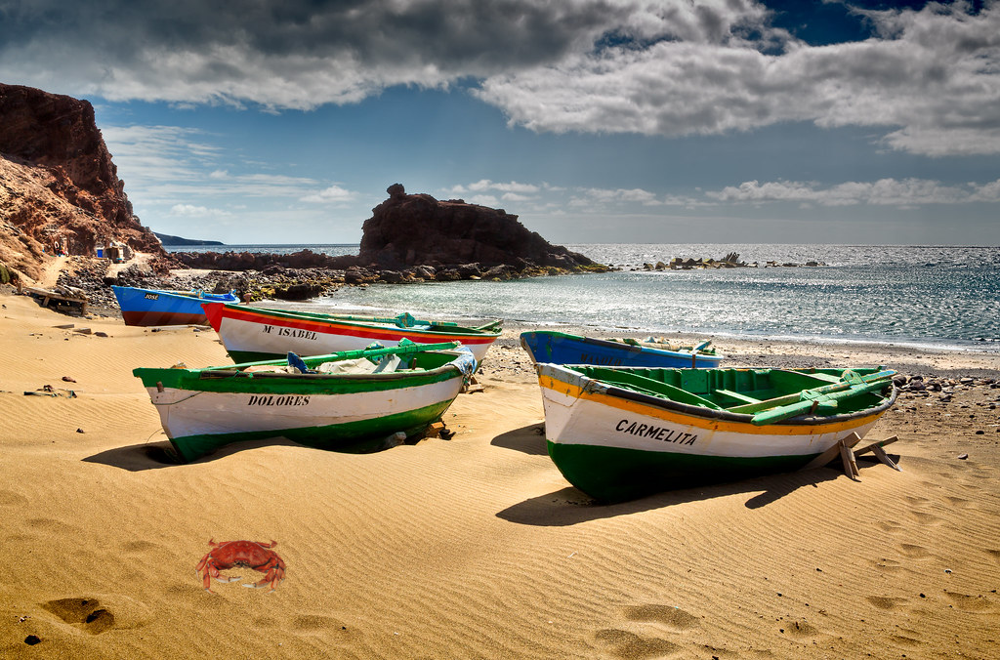

In [377]:
imggif1 = img.copy()
imggif1 = imggif1.convert(mode='RGBA')
imggif1.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif1.alpha_composite(img2)
imggif1.alpha_composite(crab, dest = (200+b, 550))
display(imggif1)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [378]:
imggif2 = img.copy()
imggif2 = imggif2.convert(mode='RGBA')
imggif2.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif2.alpha_composite(img2)
imggif2.alpha_composite(crab, dest = (200+b, 550))
#display(imggif2)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [379]:
imggif3 = img.copy()
imggif3 = imggif3.convert(mode='RGBA')
imggif3.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif3.alpha_composite(img2)
imggif3.alpha_composite(crab, dest = (200+b, 550))
#display(imggif3)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [380]:
imggif4 = img.copy()
imggif4 = imggif4.convert(mode='RGBA')
imggif4.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif4.alpha_composite(img2)
imggif4.alpha_composite(crab, dest = (200+b, 550))
#display(imggif4)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [381]:
imggif5 = img.copy()
imggif5 = imggif5.convert(mode='RGBA')
imggif5.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif5.alpha_composite(img2)
imggif5.alpha_composite(crab, dest = (200+b, 550))
#display(imggif5)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [382]:
imggif6 = img.copy()
imggif6 = imggif6.convert(mode='RGBA')
imggif6.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif6.alpha_composite(img2)
imggif6.alpha_composite(crab, dest = (200+b, 550))
#display(imggif6)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [383]:
imggif7 = img.copy()
imggif7 = imggif7.convert(mode='RGBA')
imggif7.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif7.alpha_composite(img2)
imggif7.alpha_composite(crab, dest = (200+b, 550))
#display(imggif7)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [384]:
imggif8 = img.copy()
imggif8 = imggif8.convert(mode='RGBA')
imggif8.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif8.alpha_composite(img2)
imggif8.alpha_composite(crab, dest = (200+b, 550))
#display(imggif8)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [385]:
imggif9 = img.copy()
imggif9 = imggif9.convert(mode='RGBA')
imggif9.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif9.alpha_composite(img2)
imggif9.alpha_composite(crab, dest = (200+b, 550))
#display(imggif9)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [386]:
imggif10 = img.copy()
imggif10 = imggif10.convert(mode='RGBA')
imggif10.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif10.alpha_composite(img2)
imggif10.alpha_composite(crab, dest = (200+b, 550))
#display(imggif10)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [387]:
imggif11 = img.copy()
imggif11 = imggif11.convert(mode='RGBA')
imggif11.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif11.alpha_composite(img2)
imggif11.alpha_composite(crab, dest = (200+b, 550))
#display(imggif11)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [388]:
imggif12 = img.copy()
imggif12 = imggif12.convert(mode='RGBA')
imggif12.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif12.alpha_composite(img2)
imggif12.alpha_composite(crab, dest = (200+b, 550))
#display(imggif12)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [389]:
imggif13 = img.copy()
imggif13 = imggif13.convert(mode='RGBA')
imggif13.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif13.alpha_composite(img2)
imggif13.alpha_composite(crab, dest = (200+b, 550))
#display(imggif13)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [390]:
imggif14 = img.copy()
imggif14 = imggif14.convert(mode='RGBA')
imggif14.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif14.alpha_composite(img2)
imggif14.alpha_composite(crab, dest = (200+b, 550))
#display(imggif14)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [391]:
imggif15 = img.copy()
imggif15 = imggif15.convert(mode='RGBA')
imggif15.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif15.alpha_composite(img2)
imggif15.alpha_composite(crab, dest = (200+b, 550))
#display(imggif15)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [392]:
imggif16 = img.copy()
imggif16 = imggif16.convert(mode='RGBA')
imggif16.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif16.alpha_composite(img2)
imggif16.alpha_composite(crab, dest = (200+b, 550))
#display(imggif16)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [393]:
imggif17 = img.copy()
imggif17 = imggif17.convert(mode='RGBA')
imggif17.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif17.alpha_composite(img2)
imggif17.alpha_composite(crab, dest = (200+b, 550))
#display(imggif17)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [394]:
imggif18 = img.copy()
imggif18 = imggif18.convert(mode='RGBA')
imggif18.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif18.alpha_composite(img2)
imggif18.alpha_composite(crab, dest = (200+b, 550))
#display(imggif18)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [395]:
imggif19 = img.copy()
imggif19 = imggif19.convert(mode='RGBA')
imggif19.alpha_composite(conejo_RGBA, dest = (650, 370+a))
imggif19.alpha_composite(img2)
imggif19.alpha_composite(crab, dest = (200+b, 550))
#display(imggif19)
a = a + desplazamiento_a
b = b + desplazamiento_b

In [396]:
#Vuelvo a la imagen del fondo original
#img  = Image.open(fileplaya)
img_anim = [imggif1,
            imggif2,
            imggif3,
            imggif4,
            imggif5,
            imggif6,
            imggif7,
            imggif8,
            imggif9,
            imggif10,
            imggif11,
            imggif12,
            imggif13,
            imggif14,
            imggif15,
            imggif16,
            imggif17,
            imggif18,
            imggif19,
            imggif18,
            imggif17,
            imggif16,
            imggif15,
            imggif14,
            imggif13,
            imggif12,
            imggif11,
            imggif10,
            imggif9,
            imggif8,
            imggif7,
            imggif6,
            imggif5,
            imggif4,
            imggif3,
            imggif2,
            imggif1]

In [397]:
#for i in [0, 1, 2, 3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36]:
#     display(img_anim[i])

In [406]:
duration = 100 # milisegundos que dura cada frame
img_anim[0].save("images/gifplaya.gif", save_all=True, 
                 append_images=img_anim[1:],loop=0, duration=duration)

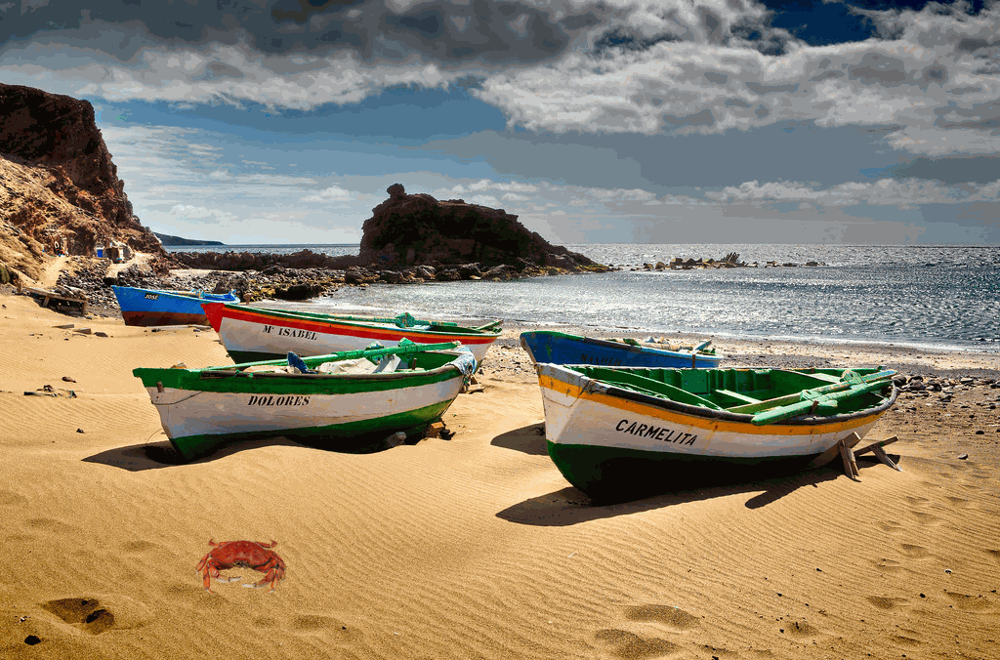

In [407]:
gif = Image.open("images/gifplaya.gif")
#print('formato:', img_gif.format)
#print('(ancho, alto) =', img_gif.size)
#print('modo: ', img_gif.mode)
#print('info adicional: ', img_gif.info)
display(gif)

In [411]:
a = 0
b = 0
sec_gif = []
for i in range (0,19):
    imggif = img.copy()
    imggif = imggif.convert(mode='RGBA')
    imggif.alpha_composite(conejo_RGBA, dest = (650, 370+a))
    imggif.alpha_composite(img2)
    imggif.alpha_composite(crab, dest = (200+b, 550))
    a = a + desplazamiento_a
    b = b + desplazamiento_b
    sec_gif.append(imggif)

In [412]:
sec_gif.extend(sec_gif[::-1])
duration = 100 # milisegundos que dura cada frame
sec_gif[0].save("images/gifburrero.gif", save_all=True, 
                 append_images=sec_gif[1:],loop=0, duration=duration)

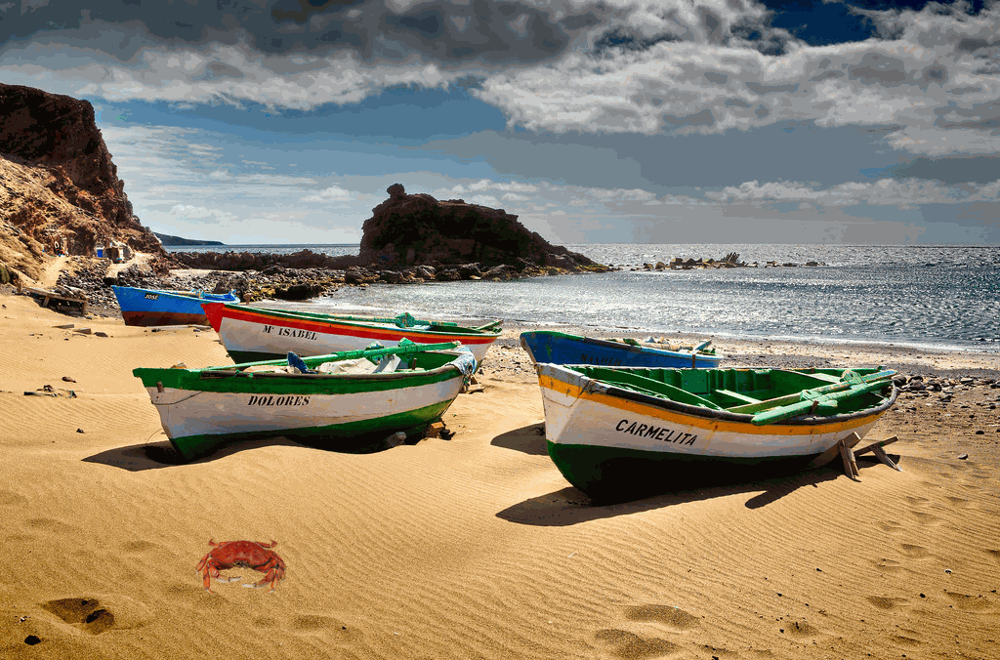

In [413]:
gif2 = Image.open("images/gifplaya.gif")
display(gif2)